# Le immagini

Per il seguente notebook sono utilizzate le librerie di python, opencv, va, matplotlib e interact

In [7]:
import numpy as np
import cv2 as cv
import va
from matplotlib import pyplot as plt
from ipywidgets import interact, interactive, fixed, interact_manual

## Immagini grayscale
Ogni immagine è rappresentata come griglia di valori in cui ciascuna cella rappresenta un singolo pixel. Un pixel è rappresentato come un byte in memoria e può assumere valori che vanno da 0 a 255. Valori tendenti allo zero assumeranno dei toni molto scuri (0 è totalemente nero) mentre valori tendenti a 255 assumeranno colorazioni chiare (255 è totalemente bianco).


Immagine nera,Immagine bianca,Pixel casuali,Immagine caricata
,,,

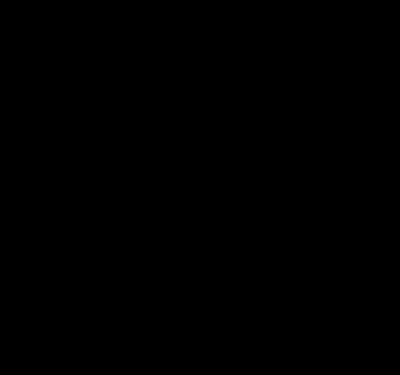
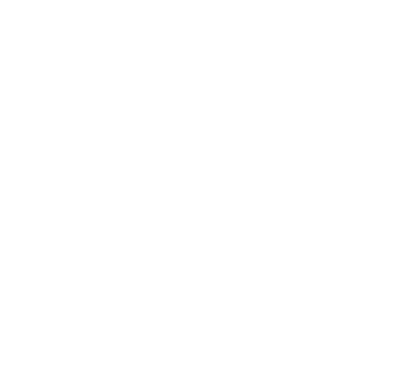
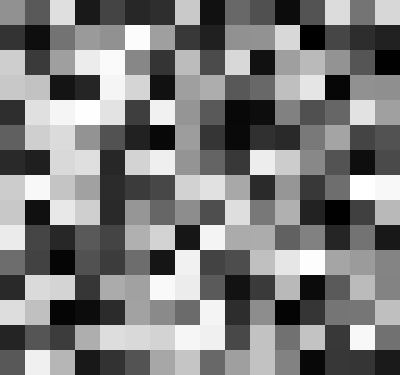
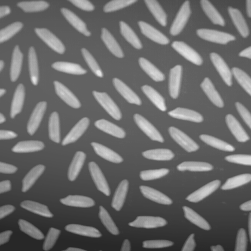

In [8]:
img1 = np.zeros((15, 16), dtype=np.uint8)                   # Crea un immagine totalmente scura
img2 = np.full((15, 16), 255, dtype=np.uint8)               # Crea un immagine totalmente bianca
img3 = np.random.randint(0, 256, (15, 16), dtype=np.uint8)  # Crea un immagine con pixel di colorazione casuale

# E' possibile caricare un immagine da file utilizzando il comando cv.imread(path, type)
# Se l'immagine non esiste verrà restituito il valore None
img4 = cv.imread("immagini/rice.png", cv.IMREAD_GRAYSCALE)

# Tramite va.show() riesco a visualizzare le quattro immagini. 
va.show((img1, "Immagine nera"), (img2, "Immagine bianca"), (img3, "Pixel casuali"),(img4, "Immagine caricata"))


Essendo degli array numpy possiamo accedere ai singoli pixel utilizzando le tecniche di indexing che già conosciamo per gli array

,,
,,

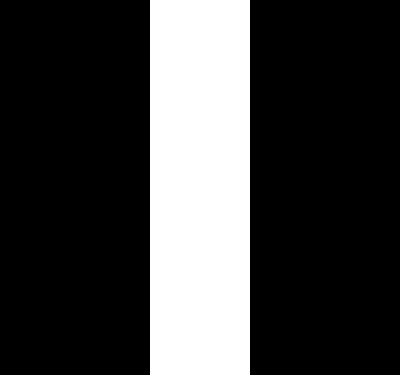
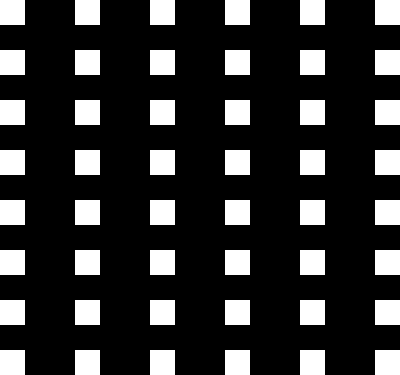
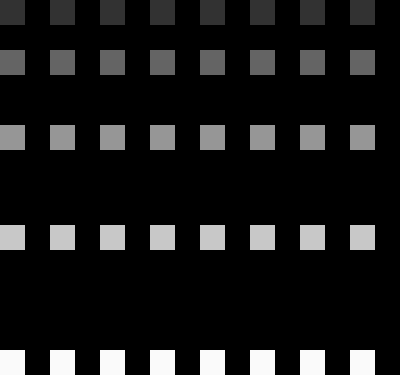

In [9]:
# Slicing + Broadcasting
img = np.zeros((15, 16), dtype = np.uint8) # Crea un immagine totalmente bianca

# Disegno una riga al centro
img[:, 6:10] = 255

# Disegno dei quadrati 
img2 = np.zeros((15, 16), dtype = np.uint8) 
img2[::2, ::3] = 255

# Applico una sfumatura di colore
img3 = np.zeros((15, 16), dtype = np.uint8)
x = np.arange(0, 16, 2)
y = np.array([0,2,5,9,14])
img3[y[:, np.newaxis], x] = np.arange(50,255,50)[:, np.newaxis]


va.show(img, img2, img3)



## Modello RGB

L'immagine è composta da 3 canali distinti che rappresentano un colore primario:
- R : Red
- G : Green 
- B : Blue

RGB è un modello additivo, sommando la luminosità dei 3 colori primari si ottengono le altre varie sfumature di colore.




(301, 400, 3)


original,red,green,blue
,,,

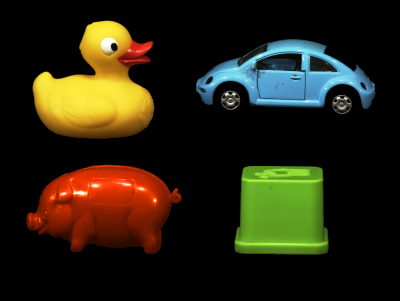
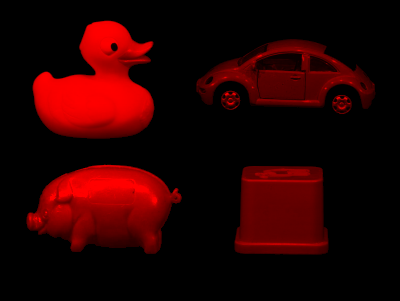
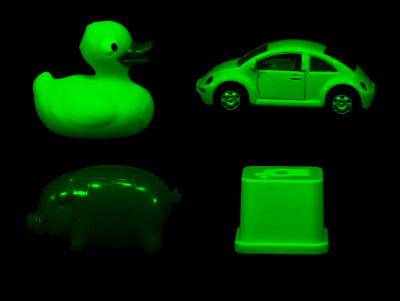
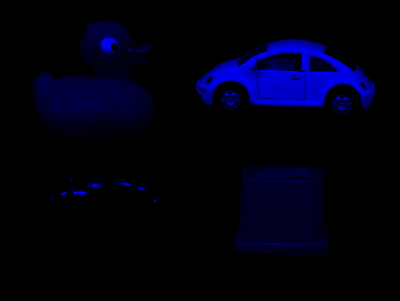

""
""

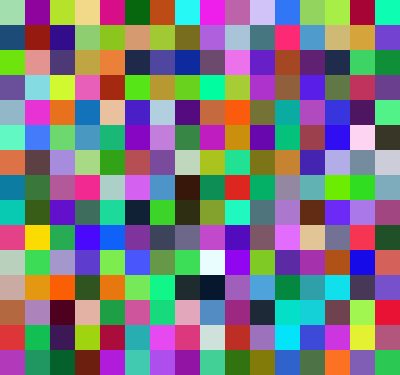

""
""

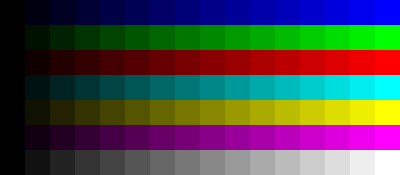

In [10]:
toys = cv.imread("immagini/toys.png")

# Toys è un array tridimensionale, l'ultima dimensione indica il numero di canali (3)
print(toys.shape)

# Visualizzazione dei tre canali 
R, G, B = toys.copy(), toys.copy(), toys.copy()
# Azzeriamo gli altri canali 
R[...,:2], G[..., 0:3:2], B[..., 1:3] = 0, 0 ,0


va.show((toys, "original"), (R, "red"), (G, "green"), (B, "blue"))


# Creo un immagine con dei pixel di colorazione casuale
img_casual = np.random.randint(0, 256, (15, 16, 3), dtype=np.uint8) # Crea un immagine con pixel di colorazione casuale

va.show(img_casual)


a = np.arange(0, 256, 17, dtype=np.uint8)
img = np.zeros((7, a.size, 3), dtype=np.uint8)


img[[0, 3, 5, 6], : , 0] = a
img[[1, 3, 4, 6], : , 1] = a
img[[2, 4, 5, 6], : , 2] = a



va.show(img)


## Slicing

,,,,,,,,,,,,,
,,,,,,,,,,,,,

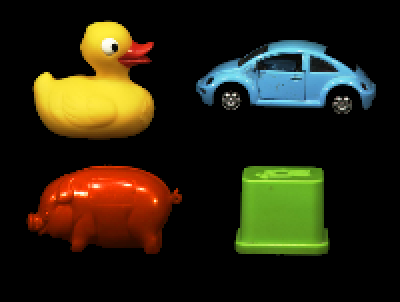
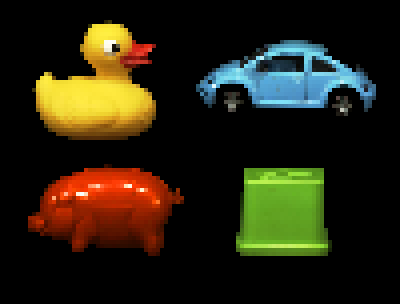
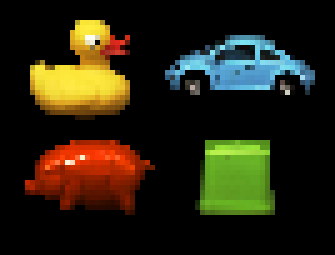
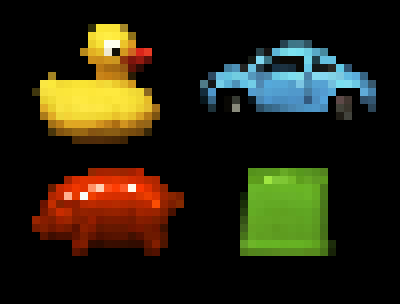
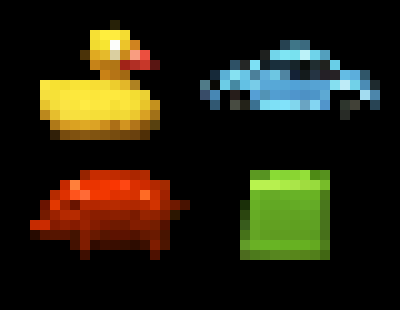
...
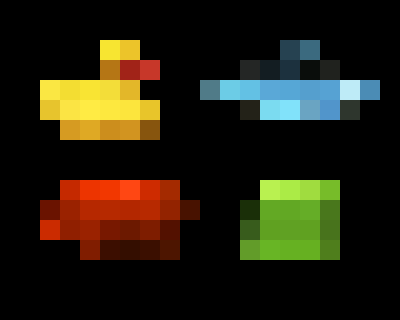
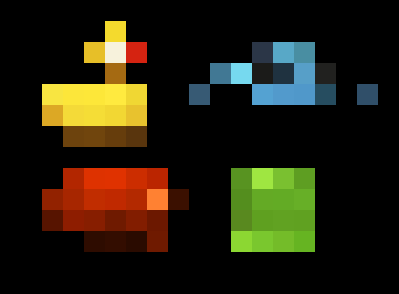
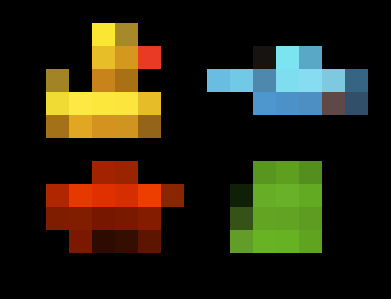
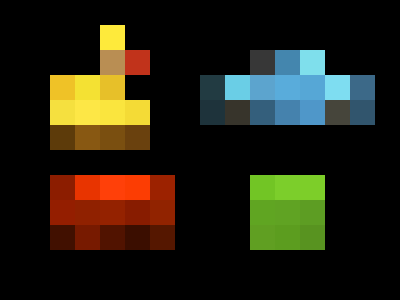
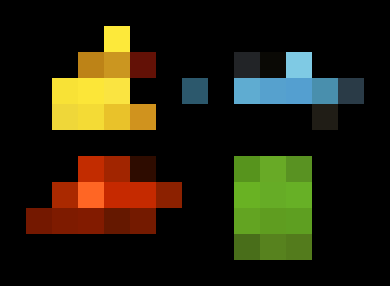

In [11]:
t = cv.imread("immagini/toys.png")
r = [t[::k,::k] for k in range(2,30,2)]
va.show(*r)

## HSL / HSV

Hue,Light,Saturation
,,

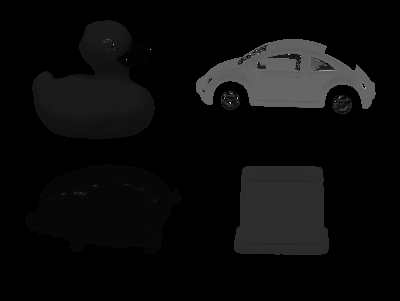
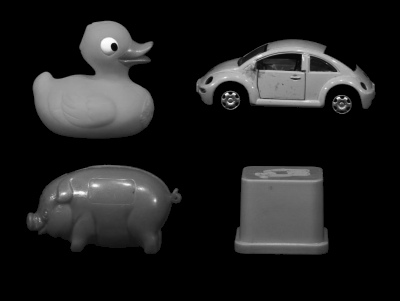
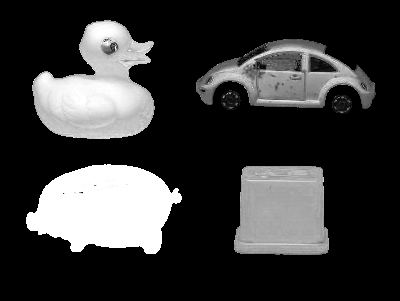

,,
,,

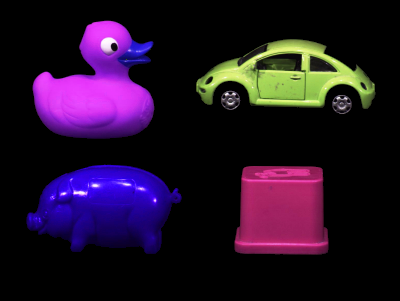
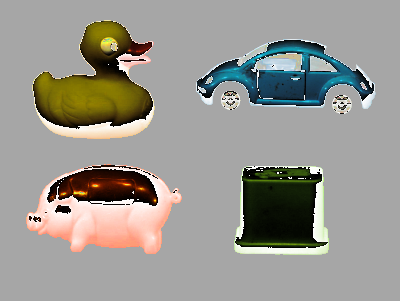
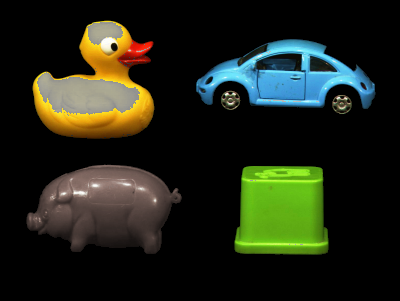

In [12]:
# Carica l'immagine originale
originale = cv.imread("immagini/toys.png")

# Converti in HLS
hls = cv.cvtColor(originale, cv.COLOR_BGR2HLS)

# Dividi i canali in h,l,s 
h,l,s = cv.split(hls)

va.show((h, "Hue"), (l, "Light"), (s, "Saturation"))

h1 = h + 120
l1 = l - 90
s1 = s - 220

risultato1 = cv.cvtColor(cv.merge((h1,l,s)), cv.COLOR_HLS2BGR)
risultato2 = cv.cvtColor(cv.merge((h,l1,s)), cv.COLOR_HLS2BGR)
risultato3 = cv.cvtColor(cv.merge((h,l,s1)), cv.COLOR_HLS2BGR)

va.show(risultato1, risultato2, risultato3)


,,,,
,,,,

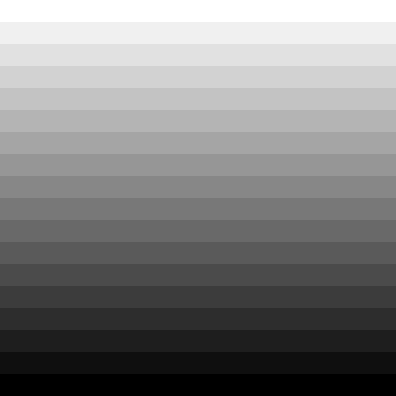
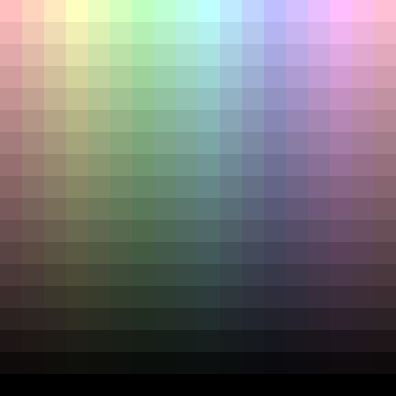
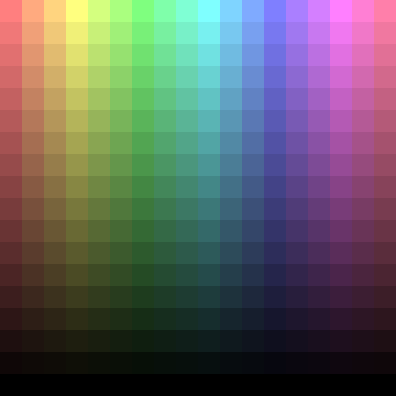
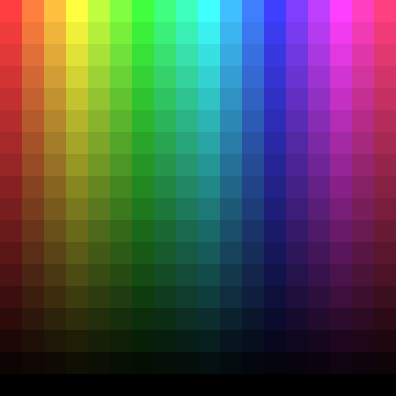
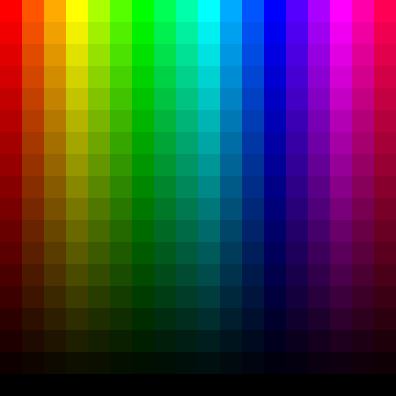

,,,,
,,,,

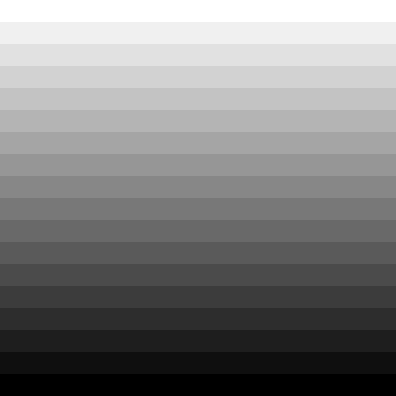
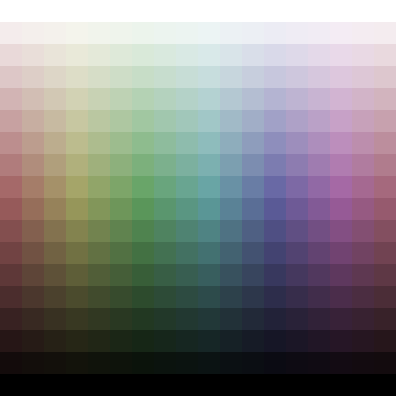
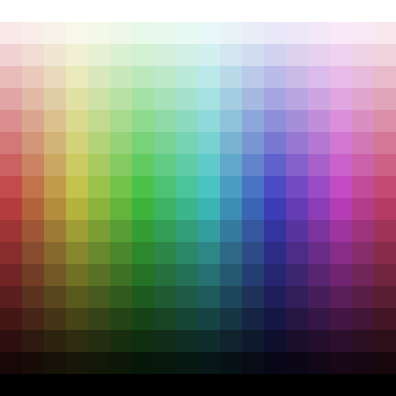
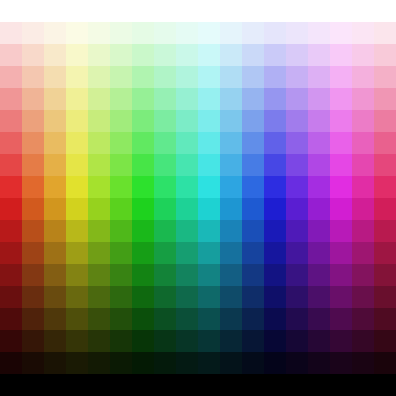
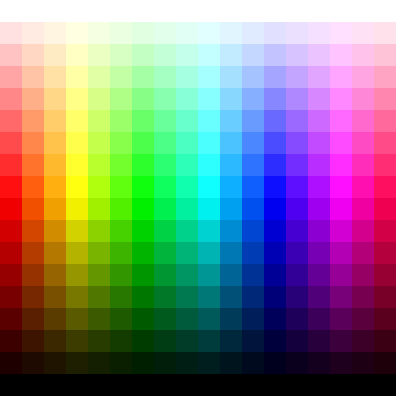

In [13]:
# Valori di saturazione
s = [0, 64, 128, 192, 255]

# Valori di luminosità
lightness = np.tile(np.arange(255, -1, -15, np.uint8)[:, np.newaxis], (1,18))

# Valori di hue 
hue = np.tile(np.arange(0, 180, 10, np.uint8), (18, 1))

# Effettuo il merge dei tre canali: hue, saturation e lightness
hsv = [cv.merge((hue, np.full_like(hue, x), lightness)) for x in s]

# Per la creazione di un array hls scambio il secondo e terzo canale di hsv
hls = [i[...,[0,2,1]] for i in hsv]

# Converto i due array in bgr per la visualizzazione
out_hsv = [cv.cvtColor(x, cv.COLOR_HSV2BGR) for x in hsv]
out_hls = [cv.cvtColor(x, cv.COLOR_HLS2BGR) for x in hls]

# Visualizzo
va.show(*out_hsv)
va.show(*out_hls)



## Istogramma

L'istogramma di un'immagine indica il quantitativo di pixel dell'immagine per ciascun livello di grigio

""
""

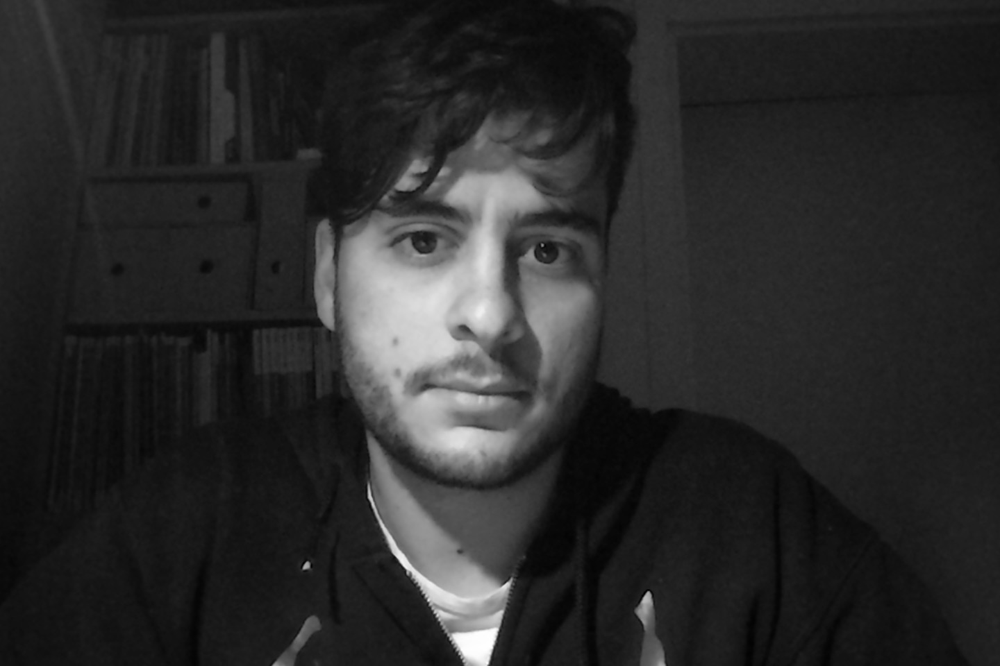

In [14]:
immagine = cv.imread("immagini/foto.jpg", cv.IMREAD_GRAYSCALE)
va.show(immagine)

# Calcolo dell'istogramma tramite la funzione cv.calcHist 
hist = cv.calcHist([immagine], [0], None, [256], [0,256])

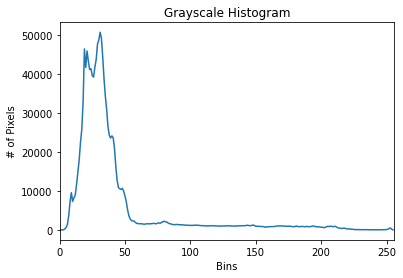

In [15]:
# Mostro istogramma 
plt.figure()
plt.title("Grayscale Histogram")
plt.xlabel("Bins")
plt.ylabel("# of Pixels")
plt.plot(hist)
plt.xlim([0, 256]);

Si nota una concentrazione di pixel scuri, l'immagine risulta essere sbilanciata.
## LUT

Se il numero di colori o livelli di grigio è inferiore al numero di pixel nell’immagine, è più efficiente memorizzare il risultato della funzione di mapping f per ogni input in un array, da utilizzare poi come tabella di lookup per eseguire l’operazione su tutti i pixel.

,,
,,

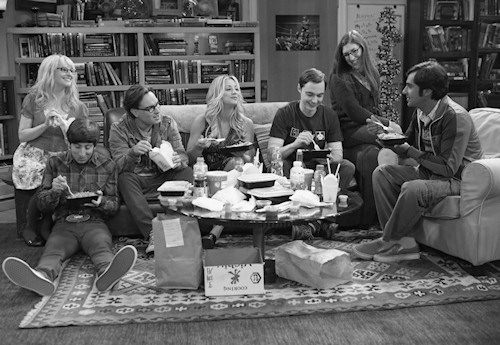
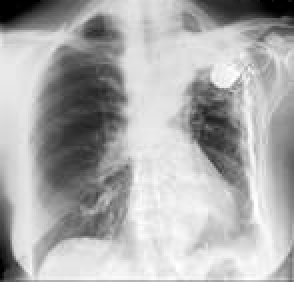
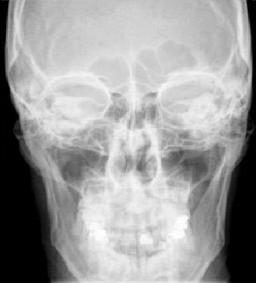

,,,,,,,,
,,,,,,,,

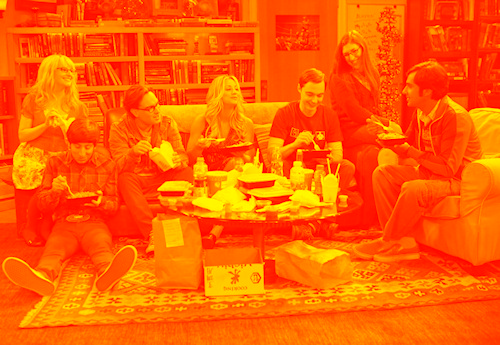
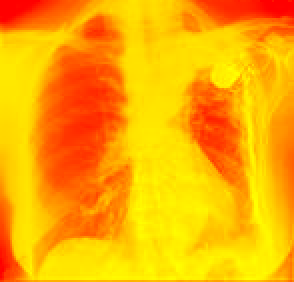
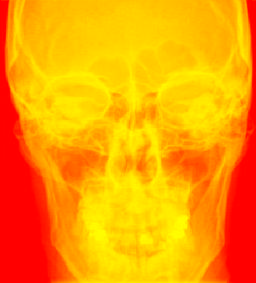
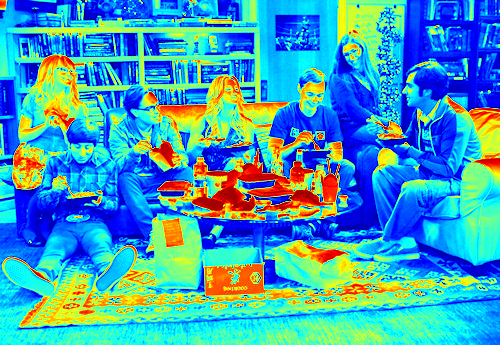
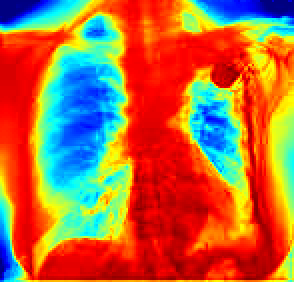
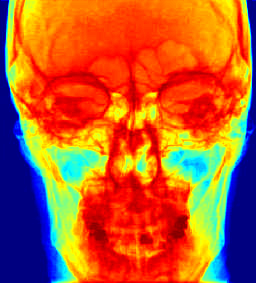
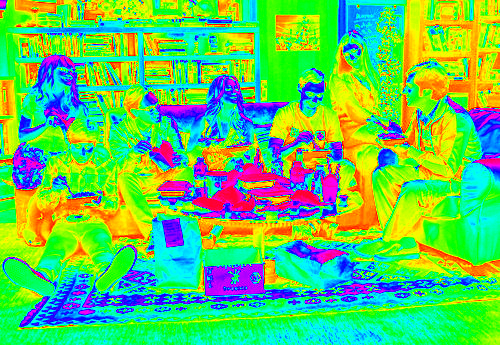
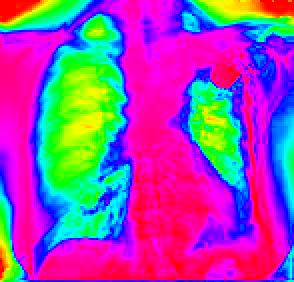
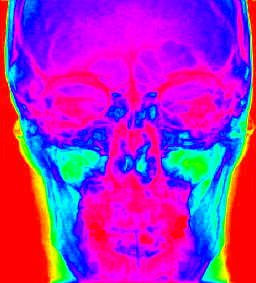

In [16]:
# Lista di immagini da convertire
imgs = [cv.imread("immagini/" + n, cv.IMREAD_GRAYSCALE) for n in ('tbbt.jpg', 'radio1.png', 'radio2.png')]

# Lookup tables
maps = (cv.COLORMAP_AUTUMN, cv.COLORMAP_JET, cv.COLORMAP_HSV)

# Immmagini colorate  
c_imgs = [cv.applyColorMap(i, m) for m in maps for i in imgs]

# Stampo le immagini originali
va.show(*imgs)

# Stampiamo le immagini con le mappe applicate
va.show(*c_imgs)


## Applicare una LUT in python

Immaginiamo di voler creare una LUT di gamma correction definita in questo modo: 

$$ 
    G(v) = 255 \times \left(\frac{v}{255}\right)^{\gamma}
$$


Numpy,OpenCV
,

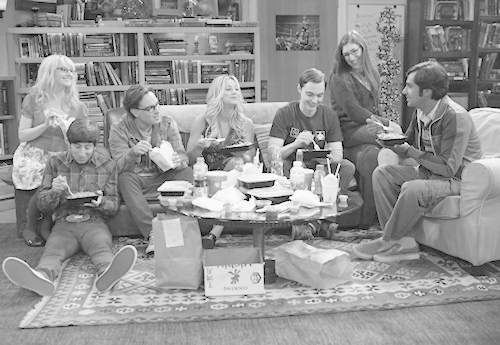
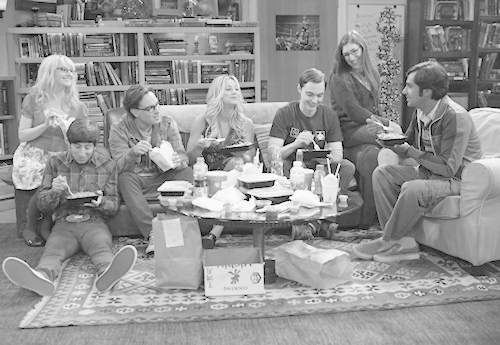

In [17]:

# Definizione della funzione 
𝛾 = 0.5
f = lambda v : 255 * (v / 255) ** 𝛾

# Array con i valori della funzione 
values = f(np.arange(256))

# Caricamento immagine a cui applicare la funzione
img = cv.imread("immagini/tbbt.jpg", cv.IMREAD_GRAYSCALE)

def np_lut(img):
    """ Applica all'immagine img la LUT tramite numpy """
    return values[img]


def cv_lut(img):
    """ Applica all'immagine img la lut adoperando la funzione LUT di OpenCV"""
    return cv.LUT(img, values)


va.show((np_lut(img),"Numpy"), (cv_lut(img), "OpenCV"))


**Nota**: La funzione cv.LUT risulta essere più veloce rispetto all'applicazione di una lut tramite NumPy

## Operazioni aritmetiche tra immagini: operatori bitwise

""
""

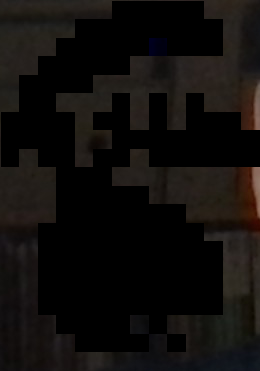

""
""

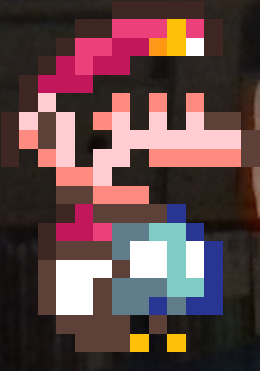

""
""

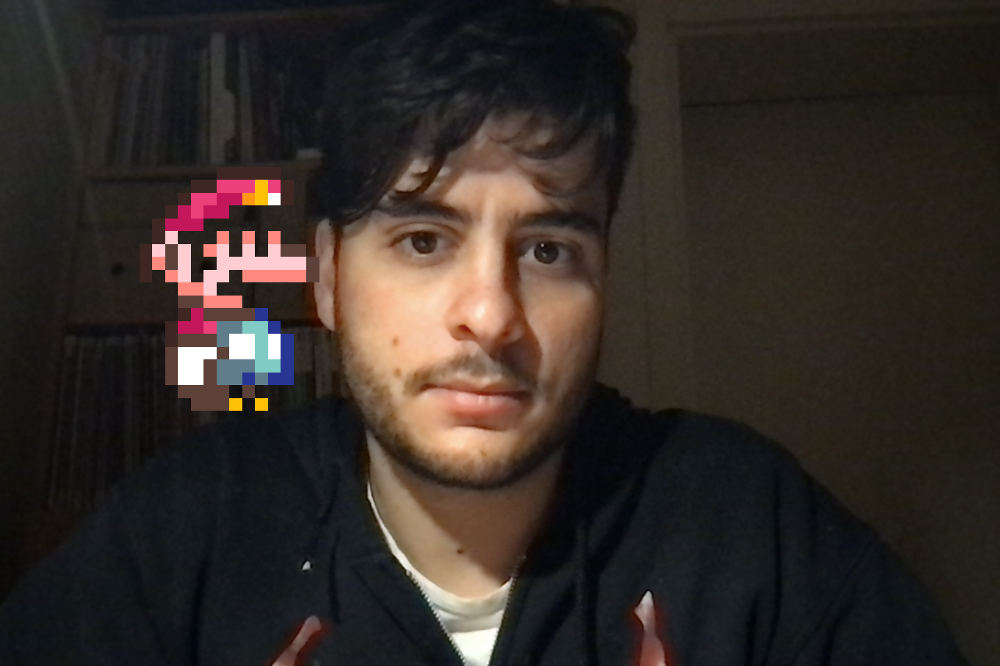

In [18]:
# Carico l'immagine di background
back = cv.imread("immagini/foto.jpg")

# Carico l'immagine da inserire
mario = cv.imread("immagini/super-mario.png")

# Creazione della maschera
mask = mario.copy()
mask[mario == 0] = 255
mask[mario != 0] = 0

# Seleziono delle coordinate arbitrarie in cui far apparire la mia immagine 
x, y = 240, 200
w, h = mario.shape[:2]
roi = back[x:x+w, y:y+h]

# Applico l'immagine
roi &= mask
va.show(roi)
roi |= mario 
va.show(roi)
va.show(back)

## Binarizzazione di un immagine

Data una soglia $t$ e una determinata immagine, si definisce l'operazione di binarizzazione la funzione : 
$$
    f(v,t) = 
    \begin{cases}
        0 & \text{if $v < t$} \\
        255 & \text{otherwise}
    \end{cases}
$$


Ovvero, al di sotto di una certa soglia t i pixel dell'immagine vengono trasformati in pixel neri o bianchi viceversa.
Possiamo scegliere la soglia:

- Manualmente, 
- Osservando l'istogramma dell'immagine, 
- Adoperando il metodo di Otsu.

Quest'ultimo parte sempre dall'osservazione dell'istogramma dell'immagine e seleziona la soglia che determina la minor varianza intra-classe dell'intensità dei pixel delle classi di background e foreground determinate dalla soglia stessa. 


Per la binarizzazione di un immagine adoperiamo la funzione `threshold` di OpenCV.

## Soglia locale

Di seguito viene presentato un esempio in cui si tenta di applicare una soglia di binarizzazione ad un'immagine avente uno sfondo non uniforme. 
I risultati che otteniamo non ci permettono in nessun caso di visualizzare correttamente tutta l'immagine.



In [19]:

@interact(t=(0,255))
def apply_threshold(t):
    img = cv.imread("immagini/sudoku.jpg", cv.IMREAD_GRAYSCALE)
    _, t = cv.threshold(img, t, 255, cv.THRESH_BINARY)
    va.show((img, "Immagine originale"), (t, "Risultato binarizzazione"))

interactive(children=(IntSlider(value=127, description='t', max=255), Output()), _dom_classes=('widget-interac…

La binarizzazione locale, a tal proposito, prende in considerazione una piccolare regione dell'immagine attorno a ciascun pixel e adopera solitamente come soglia la media dei pixel nella regione meno un valore costante.


""
""

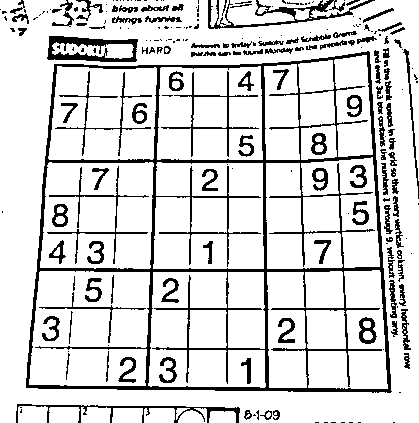

In [20]:
# Caricamento di un immagine 
img = cv.imread("immagini/sudoku.jpg", cv.IMREAD_GRAYSCALE)

# Viene presa in considerazione un riquadro di dimensioni 11x11 nell'intorno di ciascun pixel
res = cv.adaptiveThreshold(img, 255, cv.ADAPTIVE_THRESH_MEAN_C, cv.THRESH_BINARY, 11, 10)

# Mostra il risultato
va.show(res)

## Binarizzazione di un'immagine hsl

Nel prossimo esempio proviamo ad efettuare una binarizzazione dei canali di un'immagine di tipo HSL

""
""

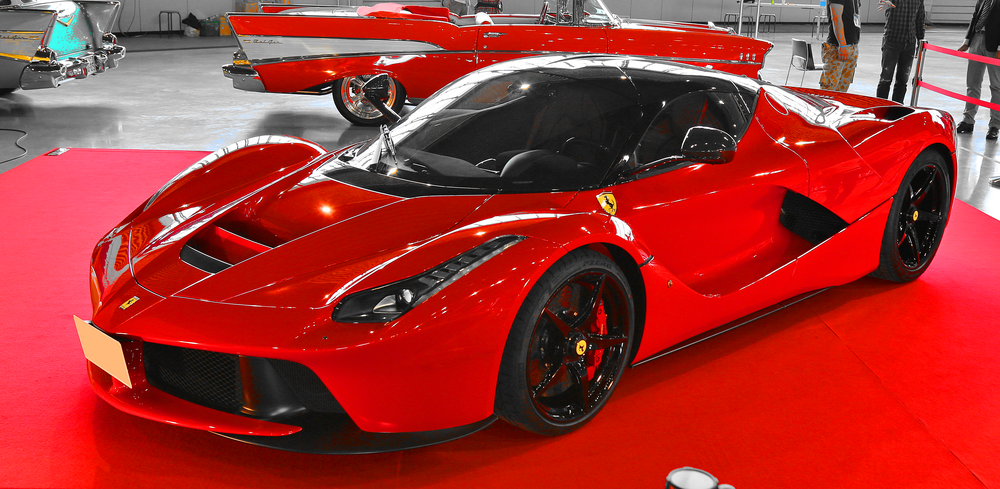

In [21]:
# Carico l'immagine e la converto successivamente in HSL
img = cv.imread("immagini/ferrari.jpg")
hls = cv.cvtColor(img, cv.COLOR_BGR2HLS)

# Lavoro solamente con il canale della saturazione, tutti i pixel inferiori ad una certa soglia assumeranno
# il colore grigio, mentre gli altri assumeranno saturazione massima 
_, hls[..., 2] = cv.threshold(hls[...,2], 100, 255, cv.THRESH_BINARY)

# Riconverto l'immagine in RGB
res = cv.cvtColor(hls, cv.COLOR_HLS2BGR)

# Mostro il risultato
va.show(res)

## Contrast Stretching

Il contrast stretching è la tecnica per la quale si espandono i livelli di grigio per aumentare il contrasto. 

La formula adoperata è :
$$
    I[y,x] = 255 \times \frac{I[y,x] - \alpha}{\beta - \alpha}
$$

Questa risulta inutile se all'interno dell'immagine è presente almeno un pixel con valore 255 e 0. 

Immagine originale,Contrasto
,

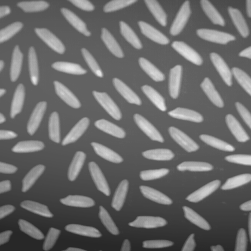
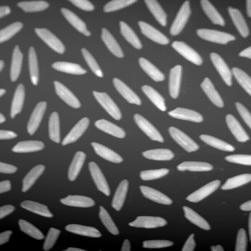

In [22]:
def contrast_stretching(img, alpha, beta):
    """
    Applica la funzione del contrast stretching ad un immagine
    """
    res = 255 * (img.astype(float) - alpha) / (beta - alpha)
    return np.clip(res, 0 , 255).astype(np.uint8)

# Carico l'immagine 
img = cv.imread("immagini/rice.png", cv.IMREAD_GRAYSCALE)

# Applico il contrast stretching
res = contrast_stretching(img, img.min(), img.max())

# Mostro il risultato
va.show((img, "Immagine originale"), (res, "Contrasto"))

## Equalizzazione dell'istogramma

E' un metodo adoperato per migliorare il contrasto dell'immagine e permettere di confrontare più immagini catturate in condizioni di luce differenti tra loro.


Per far ciò si cerca di distribuire l'istogramma uniformemente sui livelli di grigio:
   - zone meno popolate dell'istogramma vengono compresse.
   - zone molto popolate dell'istogramma vengono allargate.
    
$$
    f(v) = \sum_{i=0}^{v} H[i]
$$

Dove $H[i]$ è l'istogramma dell'immagine normalizzato:

$$
    \frac{255 \times h[i]}{\sum h[i]} \Rightarrow \sum_{0}^{255} H[i] = 255
$$


Nelle immagini a colori non è corretto applicare l'equalizzazione a ciascun canale RGB. E' opportuno trasformare l'immagine in HSL e applicare la funzione al solo canale L.


Equalizzazione Grayscale,Equalizzazione a colori
,

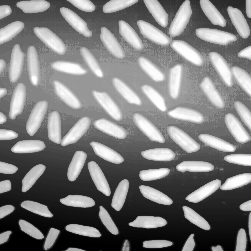
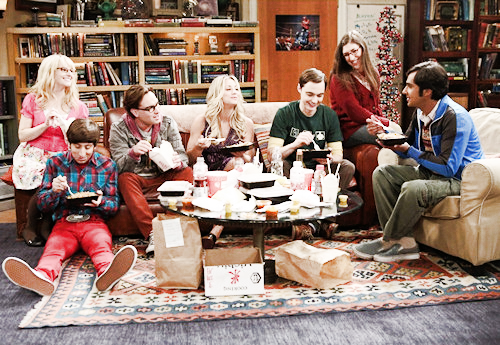

In [23]:
# Caricamento di un'immagine grayscale ed equalizzazione
img = cv.imread("immagini/rice.png", cv.IMREAD_GRAYSCALE)
eq1 = cv.equalizeHist(img)


# Caricamento di un immagine a colori e conversione in hls
img = cv.imread("immagini/tbbt.jpg")
hls = cv.cvtColor(img, cv.COLOR_BGR2HLS)

# Splitto i canali
h,l,s = cv.split(hls)

# Equalizzo il solo canale della luminosità 
l = cv.equalizeHist(l)

# Effettuo il merge dei risultati
hls = cv.merge((h,l,s))

# Converto l'immagine in RGB
eq2 = cv.cvtColor(hls, cv.COLOR_HLS2BGR)

# Mostro i risultati
va.show((eq1, "Equalizzazione Grayscale"), (eq2, "Equalizzazione a colori"))

## Numeri reali come coordinate delle immagini.

In maniera generale possiamo vedere un immagine come una funzione

$$
    I: \mathbb{N} \times \mathbb{N} \times \mathbb{N} \rightarrow \mathbb{N}
$$

per esempio se volessimo ottenere il valore del pixel in posizione (13, 4) del primo canale allora potremmo scrivere $I(13,4,0)$.
Generalmente però, possiamo considerare sia il valore delle cordinate $(x,y)$ che il relativo valore del pixel dell'immagine come numeri reali facendo rimanere invariato il canale.

$$
    I: \mathbb{R} \times \mathbb{R} \times \mathbb{N} \rightarrow \mathbb{R}
$$


Occorre prestare attenzione tuttavia ad eventuali coordinate negative, verso dell'asse y ed infine la posizione dell'origine (in alto a sinistra).

<div>
    <img src="notebook_immagini_spiegazioni/coordinate_immagini.png" width="400"/>
</div>

## Trasformazioni geometriche 

Sono delle trasformazioni che si applicano a delle coordinate dei pixel. La matrice dei pixel originale viene deformata e mappata nell'immagine di destinazione. 

### Il problema del mapping diretto 

Potremmo indicare una trasformazione geometrica come una funzione $g$ che prende in input i valori dei pixel $(x,y)$ e restituisce in output delle nuove coordinate mappate in una griglia di destinazione.
Ciò vuol dire che potremmo definre tale trasformazione come la funzione :

$$
    g: \mathbb{R} \times \mathbb{R} \rightarrow \mathbb{R} \times \mathbb{R}
$$

Tale procedimento viene definito **mapping diretto**.

**Problema** : Qualche pixel della griglia in output potrebbe non essere mappato correttamente, ovvero, potrebbe non corrispondere ad alcun pixel della griglia in input.

<div>
    <img src="notebook_immagini_spiegazioni/problema_mapping_diretto.png" width="700"/>
</div>

## Mapping inverso per la gestione delle trasformazioni geometriche

Date due immagini $I$ e $I^{'}$ rispettivamente dette immagine sorgente e destinazione $\forall (x,y) \in I^{'}$ calcolo $f(x,y)$ con $f : \mathbb{R} \times \mathbb{R} \rightarrow \mathbb{R} \times \mathbb{R} \rightarrow f = g^{-1}$

Ovvero, itero tutti i pixel dell'immagine di destinazione $I^{'}$ ed applico le coordinate di questi alla funzione immagine originale $g$. 

Anche in questo caso però ho nuovamente dei problemi:

- Come gestisco dei pixel fuori dall'immagine? 
- Come gestisco dei valori reali?





## Gestione dei pixel fuori dall'immagine.

Solitamente in questo caso ci si occupa di stimare un valore per i pixel fuori dall'immagine lavorando con il bordo.
Approcci comuni sono:

- Mantenere un colore di background costante (cv.BORDER_COSTANT)
- Si copia il valore del pixel più vicino (cv.BORDER_REPLICATE)
- L'immagine viene riflessa nei bordi (cv.BORDER_REFLECT)
- L'immagine viene repplicata nei bordi (cv.BORDER_WRAP)
- Non si adopera alcuna modifica, il pixel viene lasciato così com'è.(cv.BORDER_TRANSPARENT)


BORDER_CONSTANT,BORDER_REPLICATE,BORDER_REFLECT,BORDER_WRAP
,,,

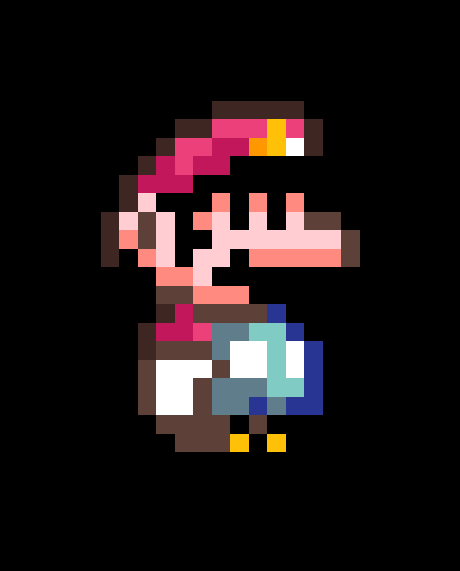
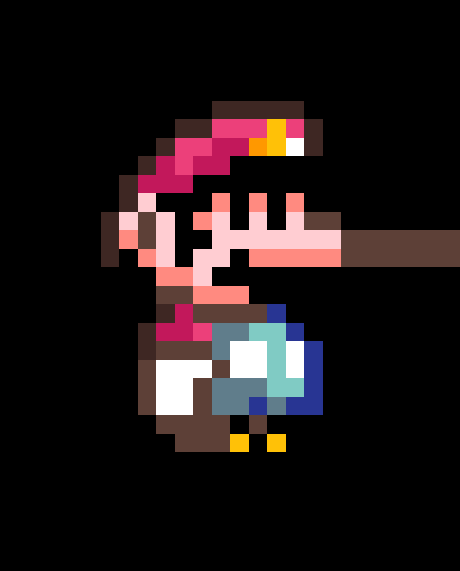
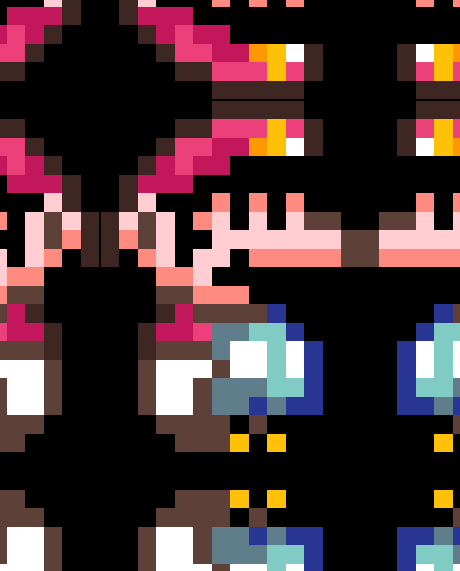
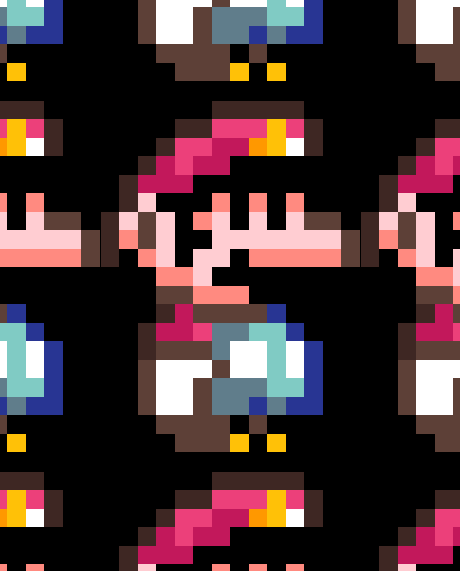

In [24]:
# Leggo un immagine 
img = cv.imread("immagini/super-mario.png")

# Genero le trasformazioni ai bordi e le visualizzo
out = [
    (cv.copyMakeBorder(img, 100, 100, 100, 100, effect), description)
    for effect, description
    in zip ([cv.BORDER_CONSTANT, cv.BORDER_REPLICATE, cv.BORDER_REFLECT, cv.BORDER_WRAP], ["BORDER_CONSTANT", "BORDER_REPLICATE", "BORDER_REFLECT", "BORDER_WRAP"])

]
va.show(*out)

## Gestione di valori di coordinate non intere

In molti casi può capitare che l'applicazione della trasformazione geometrica $f(x,y)$ produca in output delle coordinate non intere.
Per stimare il nuovo valore si prendono in considerazione i pixel adiacenti:

<div>
    <img src="notebook_immagini_spiegazioni/coordinate_non_intere1.png" width="500"/>
</div>

Tecniche che solitamente vengono adoperate sono: 


<div>
    <img src="notebook_immagini_spiegazioni/tecniche_assegnazione_valore.png"/>
</div>

## Ingrandimento e rimpicciolimento di un'immagine.

Solitamente si adoperarano le tecniche di trasformazione geometrica di un'immagine quando occorre ridimensionare quest'ultima.

INTER_NEAREST,INTER_LINEAR,INTER_CUBIC
,,

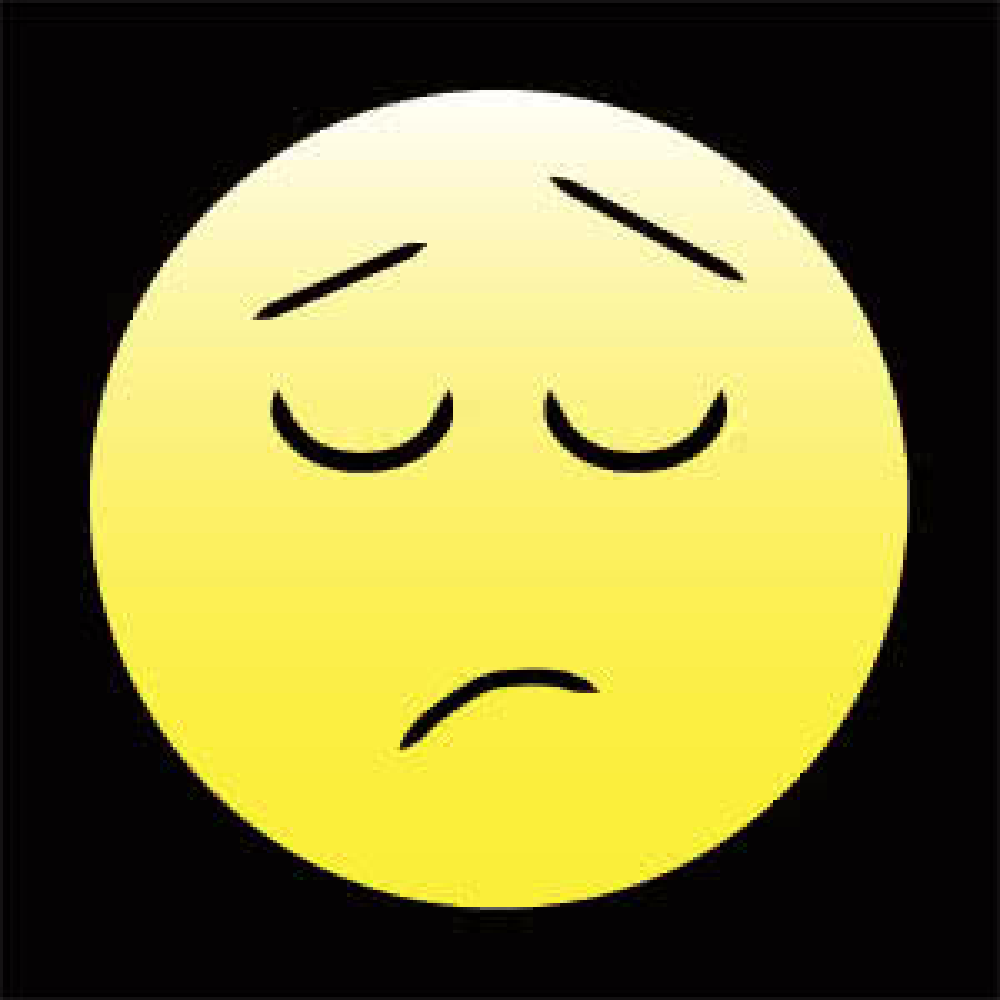
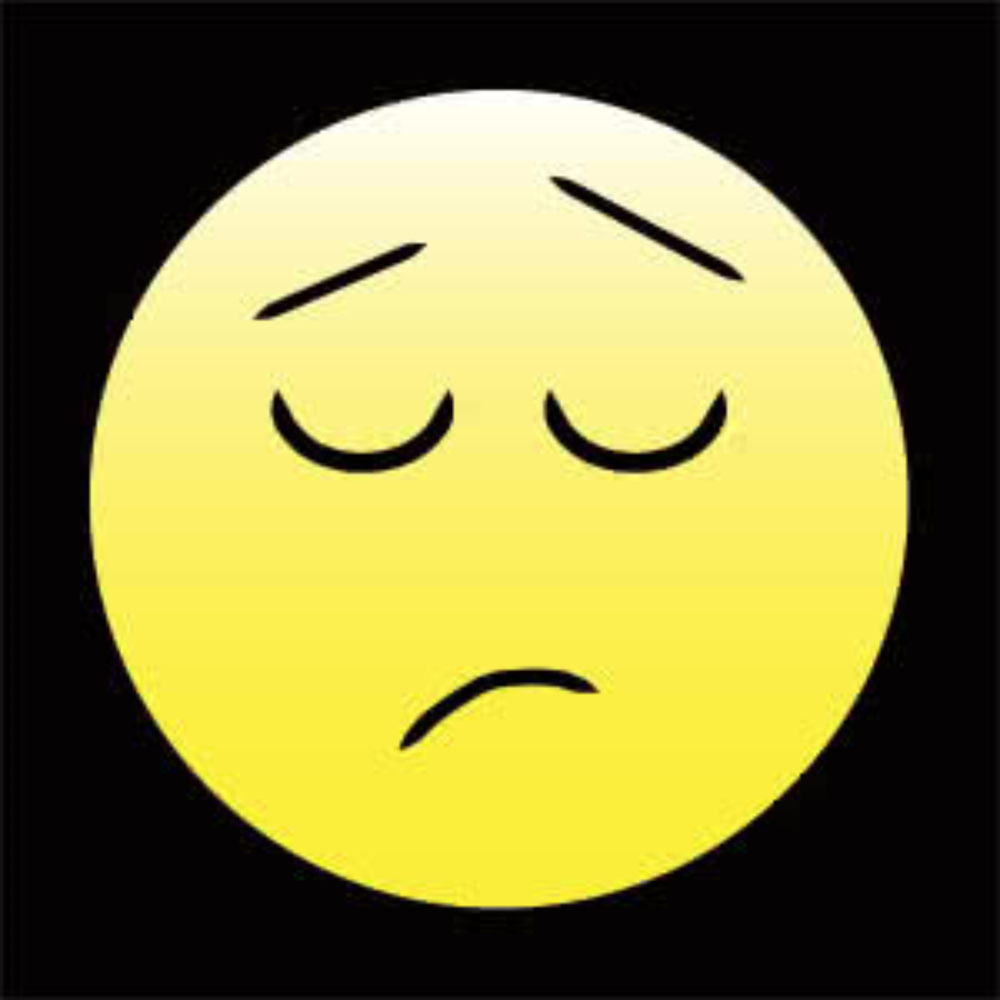
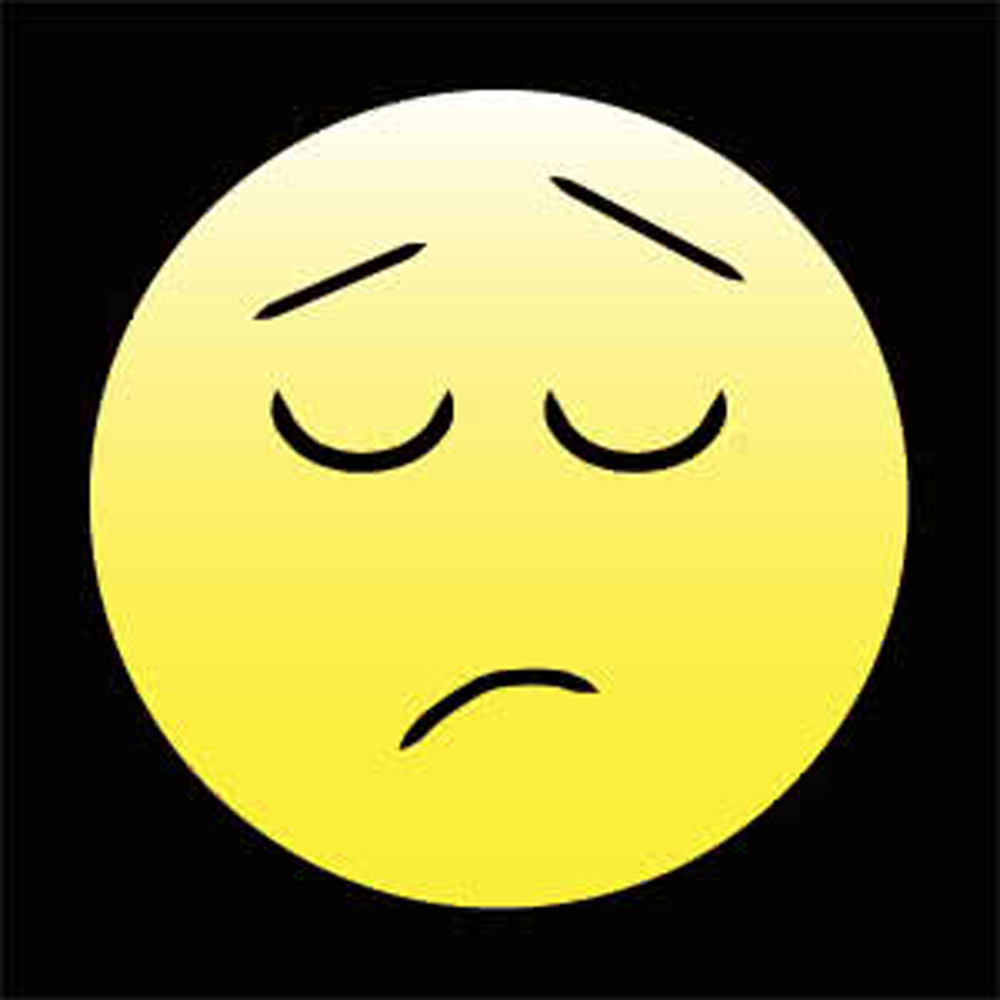

In [25]:
img = cv.imread("immagini/emoticon.jpg")
# Estraggo l'altezze e la larghezza di un'immagine
h,w = img.shape[:2]

# Scala di ingrandimento 
scale = 20

# Nuova dimensione dell'immagine
new_size = (int(w * scale), int(h * scale))

# Python possiede un metodo chiamato resize per ridimensionare l'immagine,
# a questo possiamo passare la direttiva interpolation per specificare il tipo 
# di interpolazione da applicare all'immagine in output.
out = [
    (cv.resize(img, new_size, interpolation=interp), descr) for 
    interp, descr in 
    zip(
        [cv.INTER_NEAREST, cv.INTER_LINEAR, cv.INTER_CUBIC], 
        ["INTER_NEAREST", "INTER_LINEAR", "INTER_CUBIC"]
    )
]

va.show(*out)

INTER_NEAREST risulta essere la più veloce, INTER_CUBIC risulta essere quella che fornisce il risultato migliore, INTER_LINEAR è quella che fornisce un buon compromesso come risultato.
Per il rimpicciolimento, invece, l'utilizzo di una tra INTER_NEAREST, INTER_CUBIC e INTER_LINEAR comporta il considerare un numero  di pixel troppo limitato rispetto alle informazioni presenti nell'immagine di partenza.
In questi casi in OpenCV si può utilizzare INTER_AREA che considera tutti i pixel coinvolti.

## Trasformazioni affini

Si definisce una trasformazione affine la funzione :

$$
g(x,y) = \begin{bmatrix} 
	S_{x}cos\theta & -S_{y}sin\theta \\
	S_{x}sin\theta & S_{y}cos\theta\\
	\end{bmatrix}
    \begin{bmatrix}
    x \\
    y
    \end{bmatrix}
    +
    \begin{bmatrix}
    t_{x} \\
    t_{y}
    \end{bmatrix}
$$

Questa permette : 

- Di traslare l'immagine di un angolo $\theta$ rispetto all'origine.
- Applica un fattore di scala $S_{x}$ lungo l'asse $x$ e il fattore $S_{y}$ lungo l'asse $y$. 
- Applica una traslazione $t_{x}$ lungo l'asse x e $t_{y}$ lungo l'asse $y$.

E' possibile riscriverla come
$$
\begin{bmatrix}
    x^{'} \\
    y^{'} \\
\end{bmatrix} =
\begin{bmatrix} 
	a_{00} & a_{01} \\
	a_{10} & a_{11}\\
\end{bmatrix}
\begin{bmatrix}
    x \\
    y \\
\end{bmatrix}
+
\begin{bmatrix}
    t_{x} \\
    t_{y} \\
\end{bmatrix}
$$

Ed anche come 
$$
\begin{bmatrix}
    x^{'} \\
    y^{'} \\
    1
\end{bmatrix} =
\begin{bmatrix} 
	a_{00} & a_{01} & t_{x}\\
	a_{10} & a_{11} & t_{y}\\
        0  &     0  &     1
\end{bmatrix}
\begin{bmatrix}
    x \\
    y \\
    1
\end{bmatrix}
$$

Quest'ultima forma permette di applicare contemporaneamente più trasformazioni affini moltiplicando tra loro le rispettive matrici.
Date due matrici $T_{A}$ e $T_{B}$ rappresentanti due trasformazioni affini $T_{c} = T_{A} \cdot T_{B}$ è una matrice che rappresenta la trasformazione che avviene nell'applicare $T_{A}$ e successivamente $T_{B}$. 

In OpenCV è possibile adoperare la funzione cv.warpAffine() che applica una trasformazione specificando le prime due righe della corrispondente matrice.

$$
\begin{bmatrix}
    a_{00} & a_{01} & t_{x}\\
	a_{10} & a_{11} & t_{y}\\
\end{bmatrix}
$$

La funzione provvede ad invertire la trasformazione, ottenendo $f = g^{-1}$, che applica alle coordinate dell'immagine di destinazione permettendo, inoltre, di specificare un tipo di interpolazione ed il tipo di  gestione dei bordi.


Traslazione dell'immagine,Scaling dell'immagine,Rotazione dell'immagine
,,

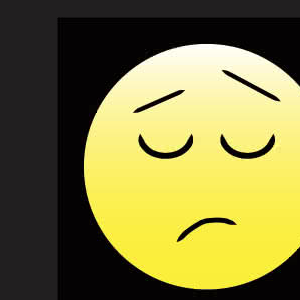
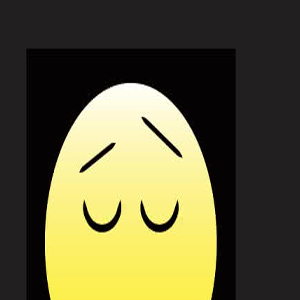
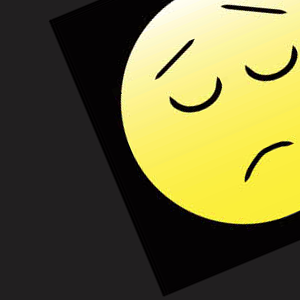

In [26]:
# Carico il modulo matematico di Python
import math

# Caricamento dell'immagine di prova
img = cv.imread("immagini/emoticon.jpg")

def apply_affine(img, M):
    """
    Applica una trasformazione affine ad un immagine.
    """
    # Estrapolo le dimensioni dell'immagine 
    h, w, _ = img.shape
    
    # Amplio il bordo dell'immagine 
    b = h // 8
    back_color_val = img[0,0].tolist()
    img = cv.copyMakeBorder(img, b, b, b, b, cv.BORDER_CONSTANT, value = back_color_val)
    
    # Applico trasformazione affine.
    # Adopero un'interpolazione cubica e un bordo costante 
    return cv.warpAffine(img, M, (w,h), None, cv.INTER_CUBIC, cv.BORDER_CONSTANT, back_color_val)


MT = np.hstack((np.identity(2), np.array([[20],[-20]])))
MS = np.array([ [0.7, 0., 0.],
                [0.0, 1.3,0.]])

# NOTA: l'asse y è rivolto verso il basso occorre negare l'angolo in modo 
# tale da ottenere una rotazione in senso antiorario.
θ = -(math.pi / 8)
sinθ, cosθ = math.sin(θ), math.cos(θ)
MR = np.array([ [cosθ, -sinθ, 0],
                [sinθ, cosθ, 0]])


# Mostra le immagini.
va.show((apply_affine(img, MT), "Traslazione dell'immagine"), (apply_affine(img, MS), "Scaling dell'immagine"), (apply_affine(img, MR), "Rotazione dell'immagine"))

## Trasformazione affine rispetto al centro dell'immagine

Traslazione nell'origine,Rortazione di π/4,Ricollocazione nell'origine,Risultato finale
,,,

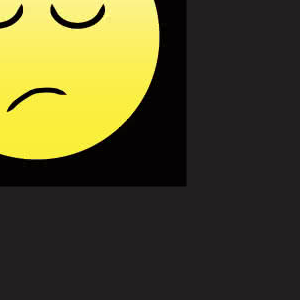
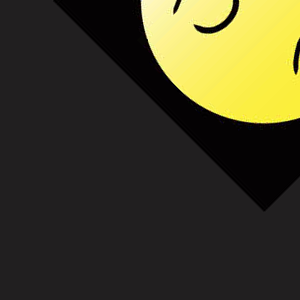
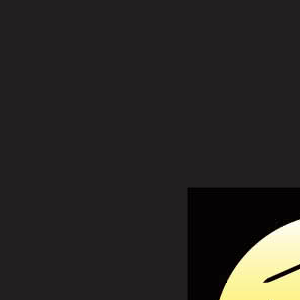
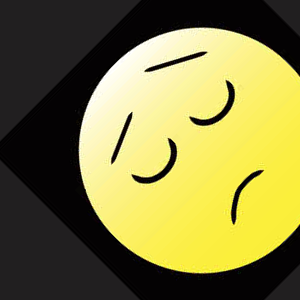

In [27]:
# Traslo l'immagine nell'origine
tx, ty = img.shape[:2]
tx /= 2; ty /= 2

# Matrice di traslazione
T1 = np.identity(3)
T1[:2, 2] = [-tx, -ty]

# Risultato 1
R1 = apply_affine(img, T1[:2])

# Roteo l'immagine di un angolo θ
θ = -(math.pi / 4)
sinθ, cosθ = math.sin(θ), math.cos(θ)
T2 = np.array([
    [cosθ, -sinθ, 0],
    [sinθ, cosθ,  0],
    [0, 0, 1]
])

# Risultato 2
R2 = apply_affine(img, T2[:2])

# Riporto l'immagine nel punto iniziale
T3 = np.identity(3)
T3[:2, 2] = [tx, ty]

# Risultato 3
R3 = apply_affine(img, T3[:2])

# Applico tutte le trasformazioni
TF = T3 @ T2 @ T1
RF = apply_affine(img, TF[:2])

# Mostro i passi effettuati
va.show((R1, "Traslazione nell'origine"), (R2, "Rortazione di π/4"), (R3, "Ricollocazione nell'origine"), (RF, "Risultato finale"))


## Trasformazioni affine da coppie di punti corrispondenti 

In OpenCV è presente la funzione getAffineTransform() che prende in input due coppie di punti corrispondendti ed applica una trasformazione affine in tal modo che ogni punto venga mappato nel suo corrispondente.

## Trasformazioni proiettive 

Tipologie di trasformazioni che non preservano il parallelismo delle rette.
Sono definite da una matrice di tipo $3\times3$:

$$
\begin{bmatrix}
    x^{'} \\
    y^{'} \\
\end{bmatrix} =
\begin{bmatrix}
    \frac{x_{c}}{w} \\
    \frac{y_{c}}{w} \\
\end{bmatrix} 
$$

in cui $ w = \begin{cases}
        Z_{c} & \text{Z_{c} \neq 0}\\
        \inf & \text{otherwise}
    \end{cases} $
    
$$
\begin{bmatrix}
    x_{c} \\
    y_{c} \\
    z_{c}
\end{bmatrix} =
M_{p}
\begin{bmatrix}
    x \\
    y \\
    1
\end{bmatrix} 
$$

 